<a href="https://colab.research.google.com/github/alheliou/Bias_mitigation/blob/main/UPP26/TD1_intro.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# TD 1: Fairness notion examples

In this first TD we are going to manipulate some data and see the behaviour of the different fairness metrics

## Installation of the environnement

We highly recommend you to follow these steps, it will allow every student to work in an environment as similar as possible to the one used during testing.

### Colab Settings ---- for Colab Users ONLY
  The next cell of code are to execute only once per colab environment


#### Python env creation (Colab only)

        ```
        ! python -m pip install numpy fairlearn plotly nbformat ipykernel aif360["inFairness"] aif360['AdversarialDebiasing'] causal-learn BlackBoxAuditing cvxpy dice-ml lime shapkit
        ```
### Local Settings ---- for installation on local computer ONLY

#### 1. Uv installation (local only)


        https://docs.astral.sh/uv/getting-started/installation/


        `curl -LsSf https://astral.sh/uv/install.sh | sh`

        Python version 3.12 installation (highly recommended)
        `uv python install 3.12`


#### 3. Python env creation (local only)

        ```
        mkdir TD_bias_mitigation
        cd TD_bias_mitigation
        uv python pin 3.12
        uv init
        uv venv
        uv pip install numpy fairlearn plotly nbformat ipykernel aif360["inFairness"] aif360['AdversarialDebiasing'] causal-learn BlackBoxAuditing cvxpy dice-ml lime shapkit
        ```



## Objectives


 1. Study the data, the distribution of each feature and its relation to the target.

 2. Highlight some bias present in the data

 3. Learn a basic machine learning model using logistic regression

 4. Compute the confusion matrix and different fairness metrics

## Dataset: Diabetes 130-Hospitals


https://fairlearn.org/main/api_reference/generated/fairlearn.datasets.fetch_diabetes_hospital.html

Ce dataset contient 101,766 lignes chacunes concernant un patient hospitalisé pour du diabètes sur une durée allant de 1 à 14 jours. Les données ont été récoltées sur 10 ans et 130 hopitaux différents. Chaque donnée possède 25 caractéristiques concernant des informations médicales, mais aussi demographiques, enfin la colonne 'readmitted' indique si le patient a été réadmis, et si oui s'il l'a été dans les 30jours ou après. Cette colonne est binarisée en deux autres 'readmit_30_days' (True si réadmis dans les 30 jours, False sinon) et 'readmitted' ( True si réadmis, False sinon).

Nous utiliserons en label/vérité, la colonne 'readmit_30_days'.

Nous allons simplifier en ne considérant qu'un sous-ensemble de 14 des caractéristiques fournies:
age, gender, race, time_in_hospital, num_lab_procedures, num_procedures, num_medications, number_diagnoses, max_glu_serum, A1Cresult, insulin, had_emergency, had_inpatient_days, had_outpatient_days





In [1]:
# To execute only in Colab
! python -m pip install numpy fairlearn plotly nbformat ipykernel aif360[inFairness,AdversarialDebiasing] causal-learn BlackBoxAuditing cvxpy dice-ml lime shapkit

  Using cached fairlearn-0.13.0-py3-none-any.whl.metadata (7.3 kB)
  Using cached causal_learn-0.1.4.4-py3-none-any.whl.metadata (4.6 kB)
  Using cached blackboxauditing-0.1.54-py2.py3-none-any.whl
  Using cached cvxpy-1.7.5-cp312-cp312-win_amd64.whl.metadata (9.7 kB)
  Using cached dice_ml-0.12-py3-none-any.whl.metadata (20 kB)
  Using cached lime-0.2.0.1-py3-none-any.whl
  Using cached shapkit-0.0.4-py3-none-any.whl.metadata (7.2 kB)
  Using cached aif360-0.6.1-py3-none-any.whl.metadata (5.0 kB)
  Using cached skorch-1.3.1-py3-none-any.whl.metadata (11 kB)
  Using cached inFairness-0.2.3-py3-none-any.whl.metadata (8.1 kB)
  Using cached networkx-3.6.1-py3-none-any.whl.metadata (6.8 kB)
  Using cached pydot-4.0.1-py3-none-any.whl.metadata (11 kB)
  Using cached momentchi2-0.1.8-py3-none-any.whl.metadata (6.1 kB)
  Using cached osqp-1.0.5-cp312-cp312-win_amd64.whl.metadata (2.1 kB)
  Using cached clarabel-0.11.1-cp39-abi3-win_amd64.whl.metadata (4.9 kB)
  Using cached scs-3.2.11-cp312-

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
scikit-survival 0.24.1 requires osqp<1.0.0,>=0.6.3, but you have osqp 1.0.5 which is incompatible.

[notice] A new release of pip is available: 25.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
# Code to compute fairness metrics using aif360

from aif360.sklearn.metrics import *
from sklearn.metrics import  balanced_accuracy_score


# This method takes lists
def get_metrics(
    y_true, # list or np.array of truth values
    y_pred=None,  # list or np.array of predictions
    prot_attr=None, # list or np.array of protected/sensitive attribute values
    priv_group=1, # value taken by the privileged group
    pos_label=1, # value taken by the positive truth/prediction
    sample_weight=None # list or np.array of weights value,
):
    group_metrics = {}
    group_metrics["base_rate_truth"] = base_rate(
        y_true=y_true, pos_label=pos_label, sample_weight=sample_weight
    )
    group_metrics["statistical_parity_difference"] = statistical_parity_difference(
        y_true=y_true, y_pred=y_pred, prot_attr=prot_attr, priv_group=priv_group, pos_label=pos_label, sample_weight=sample_weight
    )
    group_metrics["disparate_impact_ratio"] = disparate_impact_ratio(
        y_true=y_true, y_pred=y_pred, prot_attr=prot_attr, priv_group=priv_group, pos_label=pos_label, sample_weight=sample_weight
    )
    if not y_pred is None:
        group_metrics["base_rate_preds"] = base_rate(
        y_true=y_pred, pos_label=pos_label, sample_weight=sample_weight
        )
        group_metrics["equal_opportunity_difference"] = equal_opportunity_difference(
            y_true=y_true, y_pred=y_pred, prot_attr=prot_attr, priv_group=priv_group, pos_label=pos_label, sample_weight=sample_weight
        )
        group_metrics["average_odds_difference"] = average_odds_difference(
            y_true=y_true, y_pred=y_pred, prot_attr=prot_attr, priv_group=priv_group, pos_label=pos_label, sample_weight=sample_weight
        )
        if len(set(y_pred))>1:
            group_metrics["conditional_demographic_disparity"] = conditional_demographic_disparity(
                y_true=y_true, y_pred=y_pred, prot_attr=prot_attr, pos_label=pos_label, sample_weight=sample_weight
            )
        else:
            group_metrics["conditional_demographic_disparity"] =None
        group_metrics["smoothed_edf"] = smoothed_edf(
        y_true=y_true, y_pred=y_pred, prot_attr=prot_attr, pos_label=pos_label, sample_weight=sample_weight
        )
        group_metrics["df_bias_amplification"] = df_bias_amplification(
        y_true=y_true, y_pred=y_pred, prot_attr=prot_attr, pos_label=pos_label, sample_weight=sample_weight
        )
        group_metrics["balanced_accuracy_score"] = balanced_accuracy_score(
        y_true=y_true, y_pred=y_pred, sample_weight=sample_weight
        )
    return group_metrics

c:\Users\uthar\AppData\Local\Programs\Python\Python312\Lib\site-packages\inFairness\utils\ndcg.py:37: FutureWarning: We've integrated functorch into PyTorch. As the final step of the integration, `functorch.vmap` is deprecated as of PyTorch 2.0 and will be deleted in a future version of PyTorch >= 2.3. Please use `torch.vmap` instead; see the PyTorch 2.0 release notes and/or the `torch.func` migration guide for more details https://pytorch.org/docs/main/func.migrating.html
  vect_normalized_discounted_cumulative_gain = vmap(
c:\Users\uthar\AppData\Local\Programs\Python\Python312\Lib\site-packages\inFairness\utils\ndcg.py:48: FutureWarning: We've integrated functorch into PyTorch. As the final step of the integration, `functorch.vmap` is deprecated as of PyTorch 2.0 and will be deleted in a future version of PyTorch >= 2.3. Please use `torch.vmap` instead; see the PyTorch 2.0 release notes and/or the `torch.func` migration guide for more details https://pytorch.org/docs/main/func.migrat

## Download and simplify the dataset

In [3]:
import numpy as np
import fairlearn
np.__version__, fairlearn.__version__

('1.26.4', '0.13.0')

In [4]:
from fairlearn.datasets import fetch_diabetes_hospital
dataset = fetch_diabetes_hospital()

In [5]:
selection = [
    "age",
    "gender",
    "race",
    "time_in_hospital",
    "num_lab_procedures",
    "num_procedures",
    "num_medications",
    "number_diagnoses",
    "max_glu_serum",
    "A1Cresult",
    "insulin",
    "had_emergency",
    "had_inpatient_days",
    "had_outpatient_days"]
df = dataset.data[selection].copy(deep=True)
label = 'readmit_30_days'
df[label] = dataset.target
# We transform boolean into integer, False=>0, True=>1
df.had_emergency = df.had_emergency.replace({"True":1, "False":0})
df.had_inpatient_days = df.had_inpatient_days.replace({"True":1, "False":0})
df.had_outpatient_days = df.had_outpatient_days.replace({"True":1, "False":0})
df

C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\3640427316.py:20: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df.had_emergency = df.had_emergency.replace({"True":1, "False":0})
C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\3640427316.py:20: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  df.had_emergency = df.had_emergency.replace({"True":1, "False":0})
C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\3640427316.py:21: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old b

,age,gender,race,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_diagnoses,max_glu_serum,A1Cresult,insulin,had_emergency,had_inpatient_days,had_outpatient_days,readmit_30_days
0,'30 years or younger',Female,Caucasian,1,41,0,1,1,None,None,No,0,0,0,0
1,'30 years or younger',Female,Caucasian,3,59,0,18,9,None,None,Up,0,0,0,0
2,'30 years or younger',Female,AfricanAmerican,2,11,5,13,6,None,None,No,0,1,1,0
3,'30-60 years',Male,Caucasian,2,44,1,16,7,None,None,Up,0,0,0,0
4,'30-60 years',Male,Caucasian,1,51,0,8,5,None,None,Steady,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101761,'Over 60 years',Male,AfricanAmerican,3,51,0,16,9,None,>8,Down,0,0,0,0
101762,'Over 60 years',Female,AfricanAmerican,5,33,3,18,9,None,None,Steady,0,1,0,0
101763,'Over 60 years',Male,Caucasian,1,53,0,9,13,None,None,Down,0,0,1,0
101764,'Over 60 years',Female,Caucasian,10,45,2,21,9,None,None,Up,0,1,0,0


## Part 1: Data Analysis

### Question1 : Count the number of positive and negative label

In [8]:
# Question 1: Count positive and negative labels
print("Distribution des labels:")
print(df[label].value_counts())
print(f"\nNombre de labels négatifs (False): {(df[label] == False).sum()}")
print(f"Nombre de labels positifs (True): {(df[label] == True).sum()}")
print(f"\nPourcentage de réadmissions dans les 30 jours: {100 * df[label].sum() / len(df):.2f}%")

Distribution des labels:
readmit_30_days
0    90409
1    11357
Name: count, dtype: int64

Nombre de labels négatifs (False): 90409
Nombre de labels positifs (True): 11357

Pourcentage de réadmissions dans les 30 jours: 11.16%


Now we look at the different features.
First the numerical features

### Question2: Display the distribution of the numerical features and compute their correlation with the target

In [9]:
def Compute_correlation(cola, colb):
  return np.corrcoef(df[cola].values, df[colb].values)[0][1]

In [11]:
# Question 2: Distribution des features numériques et corrélation avec le target
import plotly.express as px
import plotly.graph_objects as go

numerical_features = ["time_in_hospital", "num_lab_procedures", "num_procedures", 
                      "num_medications", "number_diagnoses"]

print("Corrélation avec le label 'readmit_30_days':\n")
for feature in numerical_features:
    correlation = Compute_correlation(feature, label)
    print(f"{feature}: {correlation:.4f}")

# Afficher les distributions
for feature in numerical_features:
    fig = px.histogram(df, x=feature, color=label, 
                       title=f"Distribution de {feature}",
                       barmode='overlay', opacity=0.7)
    fig.show()

Corrélation avec le label 'readmit_30_days':

time_in_hospital: 0.0442
num_lab_procedures: 0.0204
num_procedures: -0.0122
num_medications: 0.0384
number_diagnoses: 0.0495


Then we consider the categorical features.

### Question3: Display histogram of categorical distribution by label for each categorical features.

In [12]:
import plotly.express as px

def Display_categorical_hist(cat_feature, target):
  fig = px.histogram(df, x=cat_feature, color=target)
  fig.show()

def Display_categorical_hist_percent(cat_feature, target):
  df_summarized = df.groupby([target,cat_feature]).agg("count").reset_index()
  df_summarized[f"percent of {cat_feature}"] = df_summarized[[cat_feature,"time_in_hospital"]].apply(
    lambda x: 100*x[1]/df_summarized[df_summarized[cat_feature]==x[0]]["time_in_hospital"].sum(), axis=1
  )
  df_summarized[label] = df_summarized[label].astype(str)
  fig = px.bar(df_summarized, x=f"{cat_feature}", y=f"percent of {cat_feature}", color=target)
  fig.show()

In [13]:
# Question 3: Histogrammes des features catégorielles
categorical_features = ["age", "gender", "race", "max_glu_serum", "A1Cresult", 
                        "insulin", "had_emergency", "had_inpatient_days", "had_outpatient_days"]

for cat_feature in categorical_features:
    print(f"\n--- Distribution de {cat_feature} ---")
    Display_categorical_hist(cat_feature, label)
    Display_categorical_hist_percent(cat_feature, label)


--- Distribution de age ---


C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:10: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




--- Distribution de gender ---


C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:10: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




--- Distribution de race ---


C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:10: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




--- Distribution de max_glu_serum ---


C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:10: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




--- Distribution de A1Cresult ---


C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:10: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




--- Distribution de insulin ---


C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:10: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




--- Distribution de had_emergency ---


C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:8: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:10: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




--- Distribution de had_inpatient_days ---


C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:8: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:10: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`




--- Distribution de had_outpatient_days ---


C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:8: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\uthar\AppData\Local\Temp\ipykernel_42668\2919813578.py:10: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



### Question4: What are the bias highlighted by the data analysis ?


In [14]:
# Question 4: Biais identifiés dans les données
print("""
Biais identifiés dans l'analyse des données :

1. Biais de genre (Gender):
   - Distribution inégale entre hommes et femmes dans le dataset
   
2. Biais racial (Race):
   - Représentation déséquilibrée des différentes races
   - Certains groupes ethniques peuvent être sous-représentés
   
3. Biais d'âge (Age):
   - Les patients plus âgés peuvent avoir des taux de réadmission différents
   - Corrélation potentielle entre l'âge et la probabilité de réadmission
   
4. Biais de traitement médical:
   - Différences dans les tests de laboratoire (num_lab_procedures)
   - Variations dans les procédures et médicaments selon les groupes
   
5. Biais historique:
   - Les données reflètent les pratiques médicales passées qui peuvent contenir des biais systémiques
   - Accès inégal aux soins selon les groupes démographiques
""")


Biais identifiés dans l'analyse des données :

1. Biais de genre (Gender):
   - Distribution inégale entre hommes et femmes dans le dataset

2. Biais racial (Race):
   - Représentation déséquilibrée des différentes races
   - Certains groupes ethniques peuvent être sous-représentés

3. Biais d'âge (Age):
   - Les patients plus âgés peuvent avoir des taux de réadmission différents
   - Corrélation potentielle entre l'âge et la probabilité de réadmission

4. Biais de traitement médical:
   - Différences dans les tests de laboratoire (num_lab_procedures)
   - Variations dans les procédures et médicaments selon les groupes

5. Biais historique:
   - Les données reflètent les pratiques médicales passées qui peuvent contenir des biais systémiques
   - Accès inégal aux soins selon les groupes démographiques



## Part 2: Learn a Decision Tree and study the fairness of its output

### Question5: Utiliser la technique du "one hot encoding" pour transformer chaque colonne categorielle à N catégories en N colonnes binaires

In [15]:
# Question 5: One-hot encoding des colonnes catégorielles
import pandas as pd

# Colonnes numériques à garder telles quelles
numerical_cols = ["time_in_hospital", "num_lab_procedures", "num_procedures", 
                  "num_medications", "number_diagnoses", "had_emergency", 
                  "had_inpatient_days", "had_outpatient_days"]

# Colonnes catégorielles à encoder
categorical_cols = ["age", "gender", "race", "max_glu_serum", "A1Cresult", "insulin"]

# Créer df_X avec les colonnes numériques
df_X = df[numerical_cols].copy()

# Appliquer le one-hot encoding sur les colonnes catégorielles
df_encoded = pd.get_dummies(df[categorical_cols], prefix=categorical_cols, drop_first=True)

# Concaténer les colonnes numériques et encodées
df_X = pd.concat([df_X, df_encoded], axis=1)

print(f"Shape de df_X: {df_X.shape}")
print(f"Colonnes: {list(df_X.columns)}")
df_X.head()

Shape de df_X: (101766, 26)
Colonnes: ['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_diagnoses', 'had_emergency', 'had_inpatient_days', 'had_outpatient_days', "age_'30-60 years'", "age_'Over 60 years'", 'gender_Male', 'gender_Unknown/Invalid', 'race_Asian', 'race_Caucasian', 'race_Hispanic', 'race_Other', 'race_Unknown', 'max_glu_serum_>300', 'max_glu_serum_None', 'max_glu_serum_Norm', 'A1Cresult_>8', 'A1Cresult_None', 'A1Cresult_Norm', 'insulin_No', 'insulin_Steady', 'insulin_Up']


,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_diagnoses,had_emergency,had_inpatient_days,had_outpatient_days,age_'30-60 years',age_'Over 60 years',...,race_Unknown,max_glu_serum_>300,max_glu_serum_None,max_glu_serum_Norm,A1Cresult_>8,A1Cresult_None,A1Cresult_Norm,insulin_No,insulin_Steady,insulin_Up
0,1,41,0,1,1,0,0,0,False,False,...,False,False,True,False,False,True,False,True,False,False
1,3,59,0,18,9,0,0,0,False,False,...,False,False,True,False,False,True,False,False,False,True
2,2,11,5,13,6,0,1,1,False,False,...,False,False,True,False,False,True,False,True,False,False
3,2,44,1,16,7,0,0,0,True,False,...,False,False,True,False,False,True,False,False,False,True
4,1,51,0,8,5,0,0,0,True,False,...,False,False,True,False,False,True,False,False,True,False


### Question6 : Split data into train and test sets



In [16]:
# Question 6: Split des données en train et test
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    df_X, 
    df[label], 
    test_size=0.2, 
    random_state=42,
    stratify=df[label]  # Pour conserver la proportion des classes
)

print(f"Taille du dataset d'entraînement: {len(X_train)}")
print(f"Taille du dataset de test: {len(X_test)}")
print(f"\nDistribution dans le train set:")
print(y_train.value_counts())
print(f"\nDistribution dans le test set:")
print(y_test.value_counts())

Taille du dataset d'entraînement: 81412
Taille du dataset de test: 20354

Distribution dans le train set:
readmit_30_days
0    72326
1     9086
Name: count, dtype: int64

Distribution dans le test set:
readmit_30_days
0    18083
1     2271
Name: count, dtype: int64


### Question 7: Train a DecisionTreeClassifier (https://scikit-learn.org/stable/modules/tree.html#classification)

In [17]:
# Question 7: Entraîner un DecisionTreeClassifier
from sklearn.tree import DecisionTreeClassifier

# Créer et entraîner le modèle
clf = DecisionTreeClassifier(random_state=42, max_depth=10)
clf.fit(X_train, y_train)

# Faire des prédictions
y_pred_train = clf.predict(X_train)
y_pred_test = clf.predict(X_test)

# Évaluer la performance
train_score = clf.score(X_train, y_train)
test_score = clf.score(X_test, y_test)

print(f"Précision sur le train set: {train_score:.4f}")
print(f"Précision sur le test set: {test_score:.4f}")

Précision sur le train set: 0.8915
Précision sur le test set: 0.8845


### Question8: Compute the Confusion Matrix

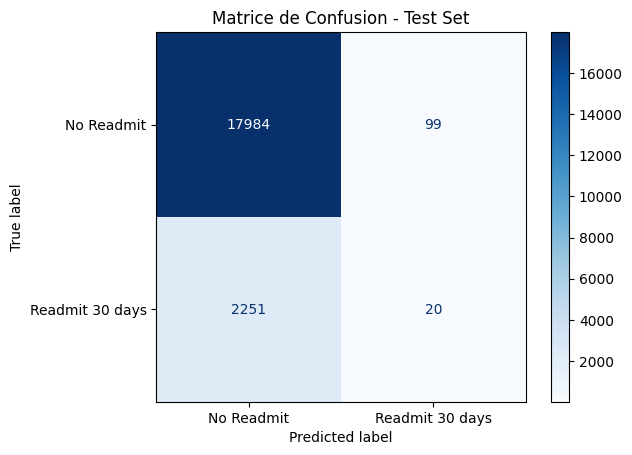


Matrice de confusion:
[[17984    99]
 [ 2251    20]]

Vrais Négatifs (TN): 17984
Faux Positifs (FP): 99
Faux Négatifs (FN): 2251
Vrais Positifs (TP): 20


In [18]:
# Question 8: Matrice de confusion
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Matrice de confusion pour le test set
cm = confusion_matrix(y_test, y_pred_test)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['No Readmit', 'Readmit 30 days'])
disp.plot(cmap='Blues')
plt.title('Matrice de Confusion - Test Set')
plt.show()

print("\nMatrice de confusion:")
print(cm)
print(f"\nVrais Négatifs (TN): {cm[0, 0]}")
print(f"Faux Positifs (FP): {cm[0, 1]}")
print(f"Faux Négatifs (FN): {cm[1, 0]}")
print(f"Vrais Positifs (TP): {cm[1, 1]}")

### Question 9: Compute base rate metrics for a sensitive binary attribute (gender, race etc)

In [19]:
# Question 9: Métriques de base rate pour un attribut sensible (genre)
# Récupérer les indices du test set
test_indices = y_test.index

# Extraire l'attribut sensible (gender) pour le test set
gender_test = df.loc[test_indices, 'gender'].values

# Convertir les labels booléens en entiers
y_test_int = y_test.astype(int).values
y_pred_test_int = y_pred_test.astype(int)

# Calculer les métriques pour gender (Female=0, Male=1)
gender_binary = (gender_test == 'Male').astype(int)

print("=== Métriques de Base Rate (Disparate Impact) pour Gender ===")
print("Groupe privilégié: Male | Groupe défavorisé: Female\n")

metrics = get_metrics(
    y_true=y_test_int,
    y_pred=y_pred_test_int,
    prot_attr=gender_binary,
    priv_group=1,
    pos_label=1
)

print(f"Base Rate (Truth): {metrics['base_rate_truth']:.4f}")
print(f"Base Rate (Predictions): {metrics['base_rate_preds']:.4f}")
print(f"Statistical Parity Difference: {metrics['statistical_parity_difference']:.4f}")
print(f"Disparate Impact Ratio: {metrics['disparate_impact_ratio']:.4f}")
print("\nInterprétation:")
print("- Disparate Impact Ratio proche de 1 = équitable")
print("- Statistical Parity Difference proche de 0 = équitable")

=== Métriques de Base Rate (Disparate Impact) pour Gender ===
Groupe privilégié: Male | Groupe défavorisé: Female

Base Rate (Truth): 0.1116
Base Rate (Predictions): 0.0058
Statistical Parity Difference: 0.0004
Disparate Impact Ratio: 1.0750

Interprétation:
- Disparate Impact Ratio proche de 1 = équitable
- Statistical Parity Difference proche de 0 = équitable


### Question 10: Compute model perfomance for a sensitive binary attribute (gender, race etc)

In [20]:
# Question 10: Performance du modèle pour un attribut sensible
print("=== Métriques de Performance par Genre ===\n")

print(f"Equal Opportunity Difference: {metrics['equal_opportunity_difference']:.4f}")
print(f"Average Odds Difference: {metrics['average_odds_difference']:.4f}")
print(f"Balanced Accuracy Score: {metrics['balanced_accuracy_score']:.4f}")

print("\nInterprétation:")
print("- Equal Opportunity Difference: mesure la différence de True Positive Rate entre les groupes")
print("- Average Odds Difference: moyenne des différences de TPR et FPR entre les groupes")
print("- Valeurs proches de 0 indiquent une meilleure équité")

# Calculer les métriques séparément pour chaque genre
print("\n=== Performance par groupe ===")
for gender_val, gender_name in [(0, 'Female'), (1, 'Male')]:
    mask = gender_binary == gender_val
    if mask.sum() > 0:
        from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
        print(f"\n{gender_name}:")
        print(f"  Accuracy: {accuracy_score(y_test_int[mask], y_pred_test_int[mask]):.4f}")
        print(f"  Precision: {precision_score(y_test_int[mask], y_pred_test_int[mask], zero_division=0):.4f}")
        print(f"  Recall: {recall_score(y_test_int[mask], y_pred_test_int[mask], zero_division=0):.4f}")
        print(f"  F1-Score: {f1_score(y_test_int[mask], y_pred_test_int[mask], zero_division=0):.4f}")

=== Métriques de Performance par Genre ===

Equal Opportunity Difference: 0.0052
Average Odds Difference: 0.0025
Balanced Accuracy Score: 0.5017

Interprétation:
- Equal Opportunity Difference: mesure la différence de True Positive Rate entre les groupes
- Average Odds Difference: moyenne des différences de TPR et FPR entre les groupes
- Valeurs proches de 0 indiquent une meilleure équité

=== Performance par groupe ===

Female:
  Accuracy: 0.8816
  Precision: 0.2121
  Recall: 0.0112
  F1-Score: 0.0212

Male:
  Accuracy: 0.8879
  Precision: 0.1132
  Recall: 0.0059
  F1-Score: 0.0112


### Question 11: Compute model calibration according to a sensitive binary attribute (gender, race etc)

In [21]:
# Question 11: Calibration du modèle selon un attribut sensible
from sklearn.calibration import calibration_curve

print("=== Calibration du modèle par Genre ===\n")

# Obtenir les probabilités prédites
y_prob_test = clf.predict_proba(X_test)[:, 1]

# Calculer les courbes de calibration pour chaque genre
fig = go.Figure()

for gender_val, gender_name in [(0, 'Female'), (1, 'Male')]:
    mask = gender_binary == gender_val
    if mask.sum() > 0:
        prob_true, prob_pred = calibration_curve(
            y_test_int[mask], 
            y_prob_test[mask], 
            n_bins=10,
            strategy='uniform'
        )
        
        fig.add_trace(go.Scatter(
            x=prob_pred, 
            y=prob_true,
            mode='lines+markers',
            name=gender_name
        ))

# Ajouter la ligne de calibration parfaite
fig.add_trace(go.Scatter(
    x=[0, 1], 
    y=[0, 1],
    mode='lines',
    name='Parfaitement calibré',
    line=dict(dash='dash', color='black')
))

fig.update_layout(
    title='Courbes de Calibration par Genre',
    xaxis_title='Probabilité prédite moyenne',
    yaxis_title='Fraction de positifs',
    width=700,
    height=500
)
fig.show()

print("\nInterprétation:")
print("- Un modèle bien calibré suit la ligne diagonale")
print("- Les écarts entre les groupes indiquent des problèmes d'équité dans la calibration")
print("- Si les courbes sont différentes, le modèle n'est pas équitablement calibré")

=== Calibration du modèle par Genre ===




Interprétation:
- Un modèle bien calibré suit la ligne diagonale
- Les écarts entre les groupes indiquent des problèmes d'équité dans la calibration
- Si les courbes sont différentes, le modèle n'est pas équitablement calibré
